# Prosper Loans Data Visualization

Prosper is a **peer-to-peer lending marketplace** in the United States.

We will analyze 113066 loan listings that took place from 2005 to 2014 on the platform

## Crisis are Dangerous

As a socially responsible business Prosper has as mission to make sure the listings offered are healty and socially responsible.

We should do our part ot avoid offering toxic products for the good of the platform.

We can see in the following graph that when a big financial economic crisis happens, as it did in 2008 the amount of listings published on the platform really decreases:

In [5]:
import altair as alt
from altair_saver import save
alt.data_transformers.disable_max_rows()

import pandas as pd

import numpy as np
import matplotlib.pyplot as plt
import seaborn as sb
%matplotlib inline

pd.options.display.max_colwidth = 2500
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 1000)


import warnings
warnings.filterwarnings('ignore')


#READ THE DATA
DF = pd.read_csv('data/prosperLoanData.csv')
DF_DESCR = pd.read_csv('data/prosperLoanData_variable_definition.csv')

#DATA CLEAINING

##DROP DUBPLICATES
df = DF.copy()

df = df[[#Features Regarding Listings
        "ListingNumber","ListingCreationDate","ListingCategory (numeric)", 
        #Features Regarding Loan
        "CreditGrade","LoanOriginationDate","LoanOriginationQuarter","LoanOriginalAmount","MonthlyLoanPayment","LoanStatus","ClosedDate", 
        #Financial Health of Borrower
        "DebtToIncomeRatio", "IncomeVerifiable","StatedMonthlyIncome","IncomeRange", "IsBorrowerHomeowner",
        #Job of Borrower
        "EmploymentStatus","EmploymentStatusDuration", "Occupation","BorrowerState",
        #User Activity
        "TotalInquiries","OpenCreditLines",
        #Key rates of the listing
        "BorrowerAPR","LenderYield"]]

## Mapping Listing Category

dict_lc = {0:"Not Available", 
           1:"Debt Consolidation",
           2:"Home Improvement",
           3:"Business",
           4:"Personal Loan",
           5:"Student Use",
           6:"Auto",
           7:"Other",
           8:"Baby&Adoption",
           9:"Boat",
           10:"Cosmetic Procedure",
           11:"Engagement Ring",
           12:"Green Loans",
           13:"Household Expenses",
           14:"Large Purchases",
           15:"Medical/Dental",
           16:"Motorcycle",
           17:"RV",
           18:"Taxes",
           19:"Vacation",
           20:"Wedding Loans"}

df["ListingCategory (Alpha)"] = [dict_lc[x] for x in df["ListingCategory (numeric)"]]
df["ListingCategory (Alpha)"].head(10)

##Change order loan origination quarter
df["LoanOriginationQuarter"] = [str(x.split(" ")[1]) + " " + str(x.split(" ")[0]) for x in df["LoanOriginationQuarter"]]


In [10]:
#GENERAL FUNCTIONS - Univariate

#used to compare number of NaNs (uninformed) vs not NaNs (informed)
def is_na(label):
    if(label == "NaN"):
        return("NaN")
    return("informed value")

#used to plot pie charts
def make_autopct(values):
    def my_autopct(pct):
        total = sum(values)
        val = int(round(pct*total/100.0))
        return '{v:d} ({p:.2f}%)'.format(p=pct,v=val)
    return my_autopct


def plot_categorical_univariate(variable, order, plotnanbars, width, height):
    
    if(order == True):
        order = list(df[variable].value_counts().index) 
    order_nan = order.copy()
    order_nan.append("NaN")
#     variable = "CreditGrade"

    df[variable + "_fillednan"] = df[variable].fillna(value = "NaN")
    df[variable + "_informed"] = [is_na(i) for i in df[variable + "_fillednan"]]
    sorted_counts = df[variable + "_informed"].value_counts()
    
    if(sorted_counts[0] != len(df[variable])): # if there are missing values
        numpics = 3
        if(plotnanbars == False):
            numpics = 2
            
        fig, ax =plt.subplots(1,numpics)
        fig.set_size_inches(width, height)

        sb.countplot(data=df, y=variable + "_fillednan",order=order,ax=ax[0]).set_title(variable + ' (No NaN)')
        if(plotnanbars==True):
            sb.countplot(data=df, y=variable + "_fillednan",order=order_nan,ax=ax[1]).set_title(variable + ' (All values)')
        plt.pie(sorted_counts, labels = sorted_counts.index, startangle = 90, counterclock = False, autopct=make_autopct(sorted_counts))
   
    else: # if there are no missing values
        fig, ax =plt.subplots(1,2)
        fig.set_size_inches(width, height)
        
        sb.countplot(data=df, y=variable + "_fillednan",ax=ax[0], order = order).set_title(variable + ' (No NaN)')
#         sb.countplot(data=df, y=variable + "_fillednan",order=order_nan,ax=ax[1]).set_title('Credit Grade (All values)')
        plt.pie(sorted_counts, labels = sorted_counts.index, startangle = 90, counterclock = False, autopct=make_autopct(sorted_counts))
    
    plt.title("Check number of informed vs missing values")
    plt.show()

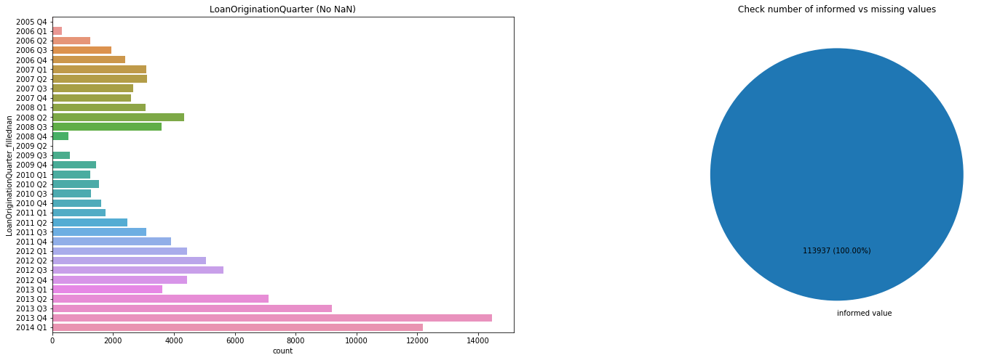

In [11]:
plot_categorical_univariate(variable = "LoanOriginationQuarter",
                            order = sorted(list(set(df["LoanOriginationQuarter"]))),
                            plotnanbars = False, #in case no NaNs this parameter does not matter
                            width = 25, 
                            height = 8)

## Comparison of Current Listings vs Successfully Completed Listings

Note that most of the current listings are published by borrowers of a salary of 50k-75k USD in comparison to a range of 25k-50k that had the succesfully completed listings as most popular range.

So in conclusion the current borrowers seem to have higher salaries, at least in the most common category.

In [16]:
df_plot = df[["IncomeRange","LoanStatus","ListingNumber"]] #subselection made to optimize altair
# df_plot = df_plot[(df_plot["LoanStatus"]!="Current") & (df_plot["LoanStatus"]!="Completed")]
custom_order = ['$0','$1-24,999','$25,000-49,999','$50,000-74,999','$75,000-99,999','$100,000+','Not employed','Not displayed']

chart = alt.Chart(df_plot, title = "Heatmap - Loan Status / Income Range").mark_rect().encode(
    alt.X('IncomeRange:O', title='IncomeRange', sort = custom_order),
    alt.Y('LoanStatus:O', title='Loan Status'),
    alt.Color('count(ListingNumber):Q', title='Count of records'),
    alt.Tooltip(["IncomeRange:O","LoanStatus:O",'count(ListingNumber):Q'])
).interactive().properties(
    width=300,
    height=200
)


chart

alt.Chart(...)

## Comparison of Current Listings vs Successfully Completed Listings

Note that the most common Debt to Income Rate for the Current listings is [0.2,0.3] in comparison to a [0.1,0.2] rating that the Completed listings had.

So in conclusion, at least in the most popular subgroup, the debt to income range of the borrowers is increasing.

In [18]:
# DebtToIncomeRatio

df_plot = df[["DebtToIncomeRatio","LoanStatus","ListingNumber"]].copy() #subselection made to optimize altair

def map_DebtToIncome(ratio):
    if ratio < 0.1:
        return("[0,0.1]")
    elif ratio < 0.2:
        return("[0.1,0.2]")
    elif ratio < 0.3:
        return("[0.2,0.3]")
    elif ratio < 0.4:
        return("[0.3,0.4]")
    elif ratio < 0.5:
        return("[0.4,0.5]")
    elif ratio < 0.6:
        return("[0.5,0.6]")
    elif ratio < 0.7:
        return("[0.6,0.7]")
    elif ratio < 0.8:
        return("[0.7,0.8]")
    elif ratio < 0.9:
        return("[0.8,0.9]")
    elif ratio < 1:
        return("[0.9,1]")
    else:
        return("+1")
    
df_plot["DebtToIncomeRatio"] = [map_DebtToIncome(x) for x in df_plot.DebtToIncomeRatio]    
    

chart = alt.Chart(df_plot, title = "Heatmap - Loan Status / Debt to Income Ratio").mark_rect().encode(
    alt.X('DebtToIncomeRatio:O', title='Debt To Income Ratio'),
    alt.Y('LoanStatus:O', title='Loan Status'),
    alt.Color('count(ListingNumber):Q', title='Count of records'),
    alt.Tooltip(["DebtToIncomeRatio:O","LoanStatus:O",'count(ListingNumber):Q'])
).interactive().properties(
    width=300,
    height=200
)


chart

alt.Chart(...)

## Should we worry?

The range of [0.2,0.3] in the debt to income ratio that we have in current listings is actually very safe,  note that it is a common rating for Credits Graded on the A-D range.

It keeps us away from the best ratings (AA) which usually have lower debt to income borrowers but it also keeps us away from the worse ratings (E, HR, NC) which also have very low debt to income ratio borrowers:

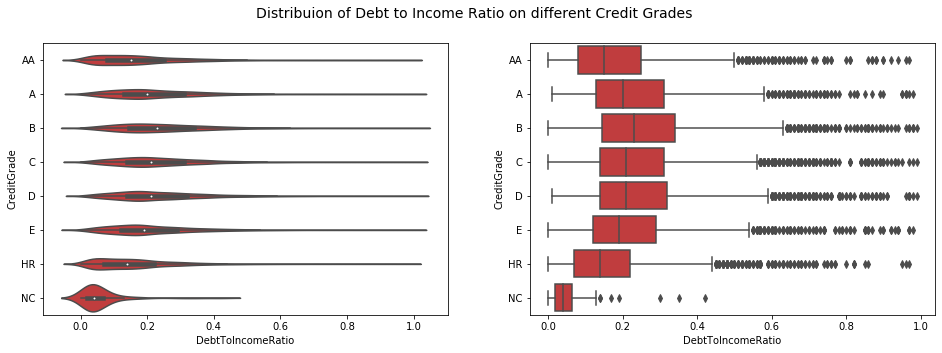

In [27]:
fig, ax = plt.subplots(1, 2, figsize=(16,5))


base_color = sb.color_palette()[3]
order = ["AA","A","B","C","D","E","HR","NC"]

sb.violinplot(data=df[df.DebtToIncomeRatio <1], y='CreditGrade', order = order, x='DebtToIncomeRatio', color=base_color, innner=None,ax = ax[0]);

sb.boxplot(data=df[df.DebtToIncomeRatio <1], y='CreditGrade', order = order, x='DebtToIncomeRatio', color=base_color, ax = ax[1]);

fig.suptitle("Distribuion of Debt to Income Ratio on different Credit Grades", fontsize=14)
plt.show()

## Is the mid-bracket where we want to be?

The mid-graded stocks (A-D) do not have the best interest, yet they dont have the worse, it is healty that most of the listings are in this bracket:

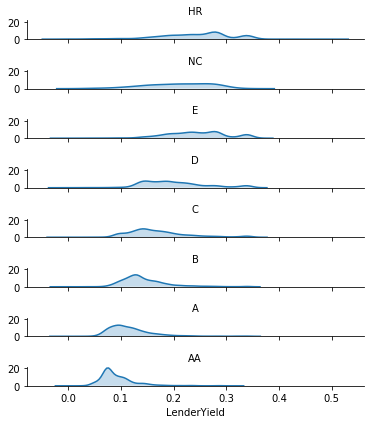

In [30]:
# group_means = df.groupby(['CreditGrade']).mean()
# group_order = group_means.sort_values(['LenderYield'], ascending = False).index
group_order = ['HR', 'NC','E','D', 'C', 'B', 'A', 'AA']

g = sb.FacetGrid(data = df, row = 'CreditGrade', size = 0.75, aspect = 7,
                 row_order = group_order)
g.map(sb.kdeplot, 'LenderYield', shade = True)
g.set_titles('{row_name}')

# plt.title("Evolution of Lender Yield on different Credit Grades")

plt.show()